<div style="width:100%; height:140px">
    <img src="https://www.kuleuven.be/internationaal/thinktank/fotos-en-logos/ku-leuven-logo.png/image_preview" width = 300px, heigh = auto align=left>
</div>


KUL H02A5a Computer Vision: Group Assignment 2
---------------------------------------------------------------
Student numbers: <span style="color:red">r1, r2, r3, r4, r5</span>. (fill in your student numbers!)

In this group assignment your team will delve into some deep learning applications for computer vision. The assignment will be delivered in the same groups from *Group assignment 1* and you start from this template notebook. The notebook you submit for grading is the last notebook you submit in the [Kaggle competition](https://www.kaggle.com/t/d11be6a431b84198bc85f54ae7e2563f) prior to the deadline on **Tuesday 24 May 23:59**. Closely follow [these instructions](https://github.com/gourie/kaggle_inclass) for joining the competition, sharing your notebook with the TAs and making a valid notebook submission to the competition. A notebook submission not only produces a *submission.csv* file that is used to calculate your competition score, it also runs the entire notebook and saves its output as if it were a report. This way it becomes an all-in-one-place document for the TAs to review. As such, please make sure that your final submission notebook is self-contained and fully documented (e.g. provide strong arguments for the design choices that you make). Most likely, this notebook format is not appropriate to run all your experiments at submission time (e.g. the training of CNNs is a memory hungry and time consuming process; due to limited Kaggle resources). It can be a good idea to distribute your code otherwise and only summarize your findings, together with your final predictions, in the submission notebook. For example, you can substitute experiments with some text and figures that you have produced "offline" (e.g. learning curves and results on your internal validation set or even the test set for different architectures, pre-processing pipelines, etc). We advise you to first go through the PDF of this assignment entirely before you really start. Then, it can be a good idea to go through this notebook and use it as your first notebook submission to the competition. You can make use of the *Group assignment 2* forum/discussion board on Toledo if you have any questions. Good luck and have fun!

---------------------------------------------------------------
NOTES:
* This notebook is just a template. Please keep the five main sections, but feel free to adjust further in any way you please!
* Clearly indicate the improvements that you make! You can for instance use subsections like: *3.1. Improvement: applying loss function f instead of g*.


# 1. Overview
This assignment consists of *three main parts* for which we expect you to provide code and extensive documentation in the notebook:
* Image classification (Sect. 2)
* Semantic segmentation (Sect. 3)
* Adversarial attacks (Sect. 4)

In the first part, you will train an end-to-end neural network for image classification. In the second part, you will do the same for semantic segmentation. For these two tasks we expect you to put a significant effort into optimizing performance and as such competing with fellow students via the Kaggle competition. In the third part, you will try to find and exploit the weaknesses of your classification and/or segmentation network. For the latter there is no competition format, but we do expect you to put significant effort in achieving good performance on the self-posed goal for that part. Finally, we ask you to reflect and produce an overall discussion with links to the lectures and "real world" computer vision (Sect. 5). It is important to note that only a small part of the grade will reflect the actual performance of your networks. However, we do expect all things to work! In general, we will evaluate the correctness of your approach and your understanding of what you have done that you demonstrate in the descriptions and discussions in the final notebook.

## 1.1 Deep learning resources
If you did not yet explore this in *Group assignment 1 (Sect. 2)*, we recommend using the TensorFlow and/or Keras library for building deep learning models. You can find a nice crash course [here](https://colab.research.google.com/drive/1UCJt8EYjlzCs1H1d1X0iDGYJsHKwu-NO).

In [713]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python

import numpy as np
import pandas as pd
import tensorflow as tf
from matplotlib import pyplot as plt

## 1.2 PASCAL VOC 2009
For this project you will be using the [PASCAL VOC 2009](http://host.robots.ox.ac.uk/pascal/VOC/voc2009/index.html) dataset. This dataset consists of colour images of various scenes with different object classes (e.g. animal: *bird, cat, ...*; vehicle: *aeroplane, bicycle, ...*), totalling 20 classes.

The training set contains 749 examples.


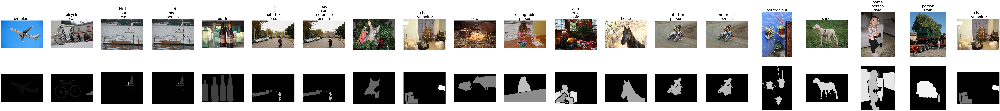

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,"[[[10, 8, 13], [16, 14, 19], [17, 14, 21], [19...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,..."


In [714]:
# Loading the training data
train_df = pd.read_csv('train/train_set.csv', index_col="Id")
labels = train_df.columns
train_df["img"] = [np.load('train/img/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
train_df["seg"] = [np.load('train/seg/train_{}.npy'.format(idx)) for idx, _ in train_df.iterrows()]
print("The training set contains {} examples.".format(len(train_df)))

# Show some examples
fig, axs = plt.subplots(2, 20, figsize=(10 * 20, 10 * 2))
for i, label in enumerate(labels):
    df = train_df.loc[train_df[label] == 1]
    axs[0, i].imshow(df.iloc[0]["img"], vmin=0, vmax=255)
    axs[0, i].set_title("\n".join(label for label in labels if df.iloc[0][label] == 1), fontsize=40)
    axs[0, i].axis("off")
    axs[1, i].imshow(df.iloc[0]["seg"], vmin=0, vmax=20)  # with the absolute color scale it will be clear that the arrays in the "seg" column are label maps (labels in [0, 20])
    axs[1, i].axis("off")
    
plt.show()

# The training dataframe contains for each image 20 columns with the ground truth classification labels and 20 column with the ground truth segmentation maps for each class
train_df.head(1)

In [715]:
# Loading the test data
test_df = pd.read_csv('test/test_set.csv', index_col="Id")
test_df["img"] = [np.load('test/img/test_{}.npy'.format(idx)) for idx, _ in test_df.iterrows()]
test_df["seg"] = [-1 * np.ones(img.shape[:2], dtype=np.int8) for img in test_df["img"]]
print("The test set contains {} examples.".format(len(test_df)))

# The test dataframe is similar to the training dataframe, but here the values are -1 --> your task is to fill in these as good as possible in Sect. 2 and Sect. 3; in Sect. 6 this dataframe is automatically transformed in the submission CSV!
test_df.head(1)

The test set contains 750 examples.


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,-1,-1,-1,-1,-1,-1,-1,-1,-1,-1,...,-1,-1,-1,-1,-1,-1,-1,-1,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


## 1.3 Your Kaggle submission
Your filled test dataframe (during Sect. 2 and Sect. 3) must be converted to a submission.csv with two rows per example (one for classification and one for segmentation) and with only a single prediction column (the multi-class/label predictions running length encoded). You don't need to edit this section. Just make sure to call this function at the right position in this notebook.

In [716]:
def _rle_encode(img):
    """
    Kaggle requires RLE encoded predictions for computation of the Dice score (https://www.kaggle.com/lifa08/run-length-encode-and-decode)

    Parameters
    ----------
    img: np.ndarray - binary img array
    
    Returns
    -------
    rle: String - running length encoded version of img
    """
    pixels = img.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    rle = ' '.join(str(x) for x in runs)
    return rle

def generate_submission(df):
    """
    Make sure to call this function once after you completed Sect. 2 and Sect. 3! It transforms and writes your test dataframe into a submission.csv file.
    
    Parameters
    ----------
    df: pd.DataFrame - filled dataframe that needs to be converted
    
    Returns
    -------
    submission_df: pd.DataFrame - df in submission format.
    """
    df_dict = {"Id": [], "Predicted": []}
    for idx, _ in df.iterrows():
        df_dict["Id"].append(f"{idx}_classification")
        df_dict["Predicted"].append(_rle_encode(np.array(df.loc[idx, labels])))
        df_dict["Id"].append(f"{idx}_segmentation")
        df_dict["Predicted"].append(_rle_encode(np.array([df.loc[idx, "seg"] == j + 1 for j in range(len(labels))])))
    
    submission_df = pd.DataFrame(data=df_dict, dtype=str).set_index("Id")
    submission_df.to_csv("submission.csv")
    return submission_df

# Data pre-processing

Functions for resizing images and augmenting the dataset. Augment only images with people to deal with class imbalance.

In [717]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import cv2

def resize_image(img, height, width):
    h = img.shape[0]
    w = img.shape[1]
    ratio = w/h
    resized = cv2.resize(img, (width, height), interpolation=cv2.INTER_CUBIC)
    """
    # Enable this and comment the previous line
    # for non-squared resizing
    
    if h <= w:
        #Horizontal orientation
        resized = cv2.resize(img, (width, height), interpolation=cv2.INTER_LINEAR)
    else:
        #Vertical orientation
        pixels_to_pad = width-int(height*ratio)
        resized = cv2.resize(img, (int(height*ratio), height), interpolation=cv2.INTER_LINEAR)
        if pixels_to_pad % 2 == 0:
            resized = cv2.copyMakeBorder(resized, 0, 0, pixels_to_pad//2, pixels_to_pad//2,
                                         cv2.BORDER_REPLICATE)
        else:
            resized = cv2.copyMakeBorder(resized, 0, 0, pixels_to_pad//2, pixels_to_pad//2+1,
                                         cv2.BORDER_REPLICATE)
    """
    return resized


def preprocess_data(X, y, shape, augment=True):
    """Resize and optionally augment the dataset
    In order to deal with class imbalance we only 
    augment the images that do not contain people.
    
    """
    
    height = shape[0]
    width = shape[1]
    X_res = []
    for i, img in enumerate(X):
        X_res.append(resize_image(img, height, width))

    X_res = np.array(X_res)

    if augment:
        to_augment = []
        to_augment_y = []
        people = []
        people_y = []
        for i, img in enumerate(X_res):
            if y[i][14] != 1:
                to_augment.append(img)
                to_augment_y.append(y[i])
            else:
                people.append(img)
                people_y.append(y[i])

        people = np.array(people)
        people_y = np.array(people_y)
        to_augment = np.array(to_augment)
        to_augment_y = np.array(to_augment_y)
    
        datagen = ImageDataGenerator(
                    rotation_range=20,
                    brightness_range=[0.3,1.0],
                    horizontal_flip=True)

        d = datagen.flow(to_augment, to_augment_y, batch_size=50, shuffle=False, seed=None)
        it = 0

        new = []
        new_y = []
        for batch in d:
            it += 1
            for i, img in enumerate(batch[0]):
                new.append(img)
                new_y.append(batch[1][i])
            if it >= 21:
                break

        new = np.array(new)
        new_y = np.array(new_y)
        
        data = np.concatenate((new, to_augment, people))
        data_y = np.concatenate((new_y, to_augment_y, people_y))
    else:
        data = X_res
        data_y = y
        
    return data, data_y

# 2. Image classification
The goal here is simple: implement a classification CNN and train it to recognise all 20 classes (and/or background) using the training set and compete on the test set (by filling in the classification columns in the test dataframe).

In [718]:
class RandomClassificationModel:
    """
    Random classification model: 
        - generates random labels for the inputs based on the class distribution observed during training
        - assumes an input can have multiple labels
    """
    def fit(self, X, y):
        """
        Adjusts the class ratio variable to the one observed in y. 

        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
        y: list of arrays - n x (nb_classes)

        Returns
        -------
        self
        """
        self.distribution = np.mean(y, axis=0)
        print("Setting class distribution to:\n{}".format("\n".join(f"{label}: {p}" for label, p in zip(labels, self.distribution))))
        return self
        
    def predict(self, X):
        """
        Predicts for each input a label.
        
        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
            
        Returns
        -------
        y_pred: list of arrays - n x (nb_classes)
        """
        np.random.seed(0)
        return [np.array([int(np.random.rand() < p) for p in self.distribution]) for _ in X]
    
    def __call__(self, X):
        return self.predict(X)
    
model = RandomClassificationModel()
model.fit(train_df["img"], train_df[labels])
test_df.loc[:, labels] = model.predict(test_df["img"])
test_df.head(1)

Setting class distribution to:
aeroplane: 0.06275033377837116
bicycle: 0.0520694259012016
bird: 0.07343124165554073
boat: 0.06408544726301736
bottle: 0.056074766355140186
bus: 0.050734312416555405
car: 0.08411214953271028
cat: 0.06008010680907877
chair: 0.09212283044058744
cow: 0.04005340453938585
diningtable: 0.06408544726301736
dog: 0.05740987983978638
horse: 0.056074766355140186
motorbike: 0.06275033377837116
person: 0.27636849132176233
pottedplant: 0.05740987983978638
sheep: 0.036048064085447265
sofa: 0.05874499332443257
train: 0.0534045393858478
tvmonitor: 0.06809078771695594


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


### Prepare the data

Before defining and training the models we need to prepare our data to be fed to the networks. For this purpose we use the previously defined functions to resize the images and augment the dataset in a way that cures the imbalance between the classes. We then divide the dataset into train and test set.

In [745]:
train_images = train_df["img"].to_numpy()
train_labels = train_df[labels].to_numpy()
IMG_SIZE = (224,224)

X, y = preprocess_data(train_images, train_labels, IMG_SIZE, augment=True)
X = X.astype(np.float32)

print("The augmented dataset contains", X.shape[0], "images")

The augmented dataset contains 1791 images


In [738]:
print(type(train_images))
print(type(train_labels))
print(type(IMG_SIZE))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'tuple'>


In [746]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

print("Training set:", X_train.shape, y_train.shape)
print("Test set:", X_test.shape, y_test.shape)

Training set: (1253, 224, 224, 3) (1253, 20)
Test set: (538, 224, 224, 3) (538, 20)


### Our first CNN model

We are now ready to define our first CNN model. ... 

Short description of the layers, role of each of them, metrics and lossfunctions used and why etc.

In [722]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.metrics import Precision, Recall
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import f1_score

In [723]:
# Define the input shape
input_shape = (IMG_SIZE[0], IMG_SIZE[1], 3)

# Define the number of classes and labels
num_classes = 20

# Define the model architecture
our_model = Sequential()
our_model.add(Conv2D(16, (3, 3), activation='relu', input_shape=input_shape))
our_model.add(MaxPooling2D((2, 2)))
our_model.add(Conv2D(32, (3, 3), activation='relu'))
our_model.add(MaxPooling2D((2, 2)))
our_model.add(Dropout(0.25))
our_model.add(Conv2D(64, (3, 3), activation='relu'))
our_model.add(MaxPooling2D((2, 2)))
our_model.add(Dropout(0.25))
our_model.add(Conv2D(128, (3, 3), activation='relu'))
our_model.add(MaxPooling2D((2, 2)))
our_model.add(Dropout(0.25))
our_model.add(Flatten())
our_model.add(Dense(512, activation='relu'))
our_model.add(Dropout(0.5))
our_model.add(Dense(num_classes, activation='sigmoid'))

# Compile the model
our_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['Precision', 'Recall'])

# Print a summary of the model architecture
our_model.summary()

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_419 (Conv2D)         (None, 222, 222, 16)      448       
                                                                 
 max_pooling2d_169 (MaxPooli  (None, 111, 111, 16)     0         
 ng2D)                                                           
                                                                 
 conv2d_420 (Conv2D)         (None, 109, 109, 32)      4640      
                                                                 
 max_pooling2d_170 (MaxPooli  (None, 54, 54, 32)       0         
 ng2D)                                                           
                                                                 
 dropout_41 (Dropout)        (None, 54, 54, 32)        0         
                                                                 
 conv2d_421 (Conv2D)         (None, 52, 52, 64)      

In [724]:
history = our_model.fit(X_train, y_train, epochs=15, batch_size=16, validation_split=0.2)

Epoch 1/15
 9/63 [===>..........................] - ETA: 1:00 - loss: 8.6178 - precision: 0.0714 - recall: 0.1099

KeyboardInterrupt: 

KeyError: 'precision'

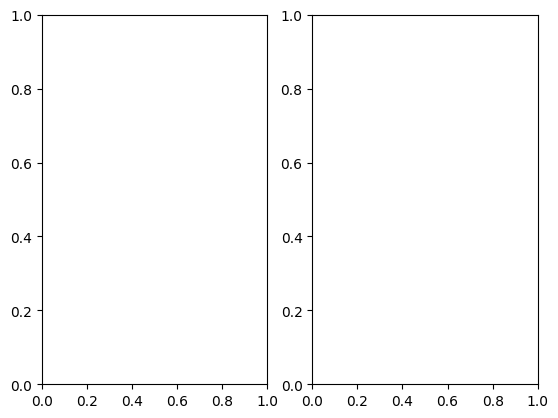

In [725]:
# Visualize the results

fig, axs = plt.subplots(1,2)
# summarize history for precision
axs[0].plot(history.history['precision'])
axs[0].plot(history.history['val_precision'])
axs[0].set_title('model precision')
axs[0].set_ylabel('precision')
axs[0].set_xlabel('epoch')
axs[0].legend(['train', 'val'], loc='upper left')

# summarize history for loss
axs[1].plot(history.history['loss'])
axs[1].plot(history.history['val_loss'])
axs[1].set_title('model loss')
axs[1].set_ylabel('loss')
axs[1].set_xlabel('epoch')
axs[1].legend(['train', 'val'], loc='upper left')

plt.show()

In [ ]:
# Make predictions

y_pred_prob = our_model.predict(X_test)

17/17 [==============================] - 2s 108ms/step


In [ ]:
# Experiment with the following threshold to get
# the best f1 score. Should be around 0.3-0.5
threshold = 0.3

y_pred = np.array(y_pred_prob>threshold, int)

f1 = f1_score(y_test, y_pred, average='weighted')
print('F1 score:', f1)

F1 score: 0.3463707864603056


### Discussion - Remarks about the model

Plot some examples, suggestions for different architecture

## Transfer Learning - ResNet50 

We take the pre-trained model ResNet50 and adjust it to our specific classification problem. ...

In [727]:
IMG_SIZE = (224,224)
height,width=IMG_SIZE[0],IMG_SIZE[1]

resnet_model = tf.keras.Sequential()

# Start by importing the pre-defined model
imported_model= tf.keras.applications.ResNet50(include_top=False,
                                               input_shape=(height,width,3),
                                               pooling='avg',classes=20,
                                               weights='imagenet')

for layer in imported_model.layers:
    layer.trainable=False

resnet_model.add(tf.keras.layers.Lambda(tf.keras.applications.resnet50.preprocess_input, input_shape=(height, width, 3)))
resnet_model.add(imported_model)

# Add some more layers to adjust the network to our secific task
resnet_model.add(Flatten())
resnet_model.add(Dense(512, activation='relu'))
resnet_model.add(Dense(20, activation='sigmoid'))

resnet_model.summary()

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lambda_13 (Lambda)          (None, 224, 224, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 2048)              23587712  
                                                                 
 flatten_7 (Flatten)         (None, 2048)              0         
                                                                 
 dense_31 (Dense)            (None, 512)               1049088   
                                                                 
 dense_32 (Dense)            (None, 20)                10260     
                                                                 
Total params: 24,647,060
Trainable params: 1,059,348
Non-trainable params: 23,587,712
_________________________________________________________________


In [728]:
# Compile and train the model

resnet_model.compile(optimizer=Adam(learning_rate=0.001),loss='binary_crossentropy',metrics=['Precision', 'Recall'])
history = resnet_model.fit(X_train, y_train, validation_split=0.2, epochs=5, batch_size=16)

Epoch 1/5
63/63 [==============================] - 145s 2s/step - loss: 0.1541 - precision: 0.6298 - recall: 0.5223 - val_loss: 0.0795 - val_precision: 0.8125 - val_recall: 0.7429
Epoch 2/5
63/63 [==============================] - 132s 2s/step - loss: 0.0417 - precision: 0.9289 - recall: 0.8489 - val_loss: 0.0619 - val_precision: 0.9112 - val_recall: 0.7492
Epoch 3/5
63/63 [==============================] - 130s 2s/step - loss: 0.0198 - precision: 0.9762 - recall: 0.9319 - val_loss: 0.0516 - val_precision: 0.8938 - val_recall: 0.8286
Epoch 4/5
63/63 [==============================] - 135s 2s/step - loss: 0.0109 - precision: 0.9897 - recall: 0.9757 - val_loss: 0.0478 - val_precision: 0.9010 - val_recall: 0.8381
Epoch 5/5
63/63 [==============================] - 135s 2s/step - loss: 0.0060 - precision: 0.9984 - recall: 0.9937 - val_loss: 0.0501 - val_precision: 0.9176 - val_recall: 0.8127


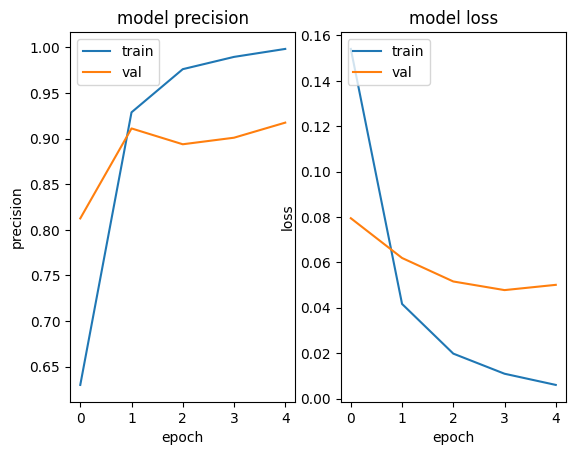

In [729]:
# Visualize the results

fig, axs = plt.subplots(1,2)
# summarize history for precision
axs[0].plot(history.history['precision'])
axs[0].plot(history.history['val_precision'])
axs[0].set_title('model precision')
axs[0].set_ylabel('precision')
axs[0].set_xlabel('epoch')
axs[0].legend(['train', 'val'], loc='upper left')

# summarize history for loss
axs[1].plot(history.history['loss'])
axs[1].plot(history.history['val_loss'])
axs[1].set_title('model loss')
axs[1].set_ylabel('loss')
axs[1].set_xlabel('epoch')
axs[1].legend(['train', 'val'], loc='upper left')

plt.show()

In [747]:
# Make predictions

y_pred_prob = resnet_model.predict(X_test)

17/17 [==============================] - 51s 3s/step


In [748]:
# Evaluate the model

# Experiment with the threshold to get the best 
# score. It should be around 0.5
threshold = 0.4

y_pred = np.array(y_pred_prob>threshold, int)
print(y_pred.shape)
print(y_pred[36])
print(y_test[36])

f1 = f1_score(y_test, y_pred, average='weighted')
print('F1 score:', f1)


(538, 20)
[0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0]
[0 0 0 0 0 0 0 0 1 0 1 0 0 0 0 0 0 0 0 0]
F1 score: 0.8574570679039725


### Discussion - remarks

Plot some examples, improvements etc.

## Predictions for submission

Choose the best model (resnet) and use it to predict the labels for the test set.

In [ ]:
to_test = []
for i, img in enumerate(test_df["img"]):
    to_test.append(resize_image(img, IMG_SIZE[0], IMG_SIZE[1]))    
to_test = np.array(to_test, dtype=np.float32)

test_pred_prob = resnet_model.predict(to_test)
test_pred = np.array(test_pred_prob>threshold, int)

24/24 [==============================] - 36s 1s/step


[0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 1 0 0]


<function matplotlib.pyplot.show(close=None, block=None)>

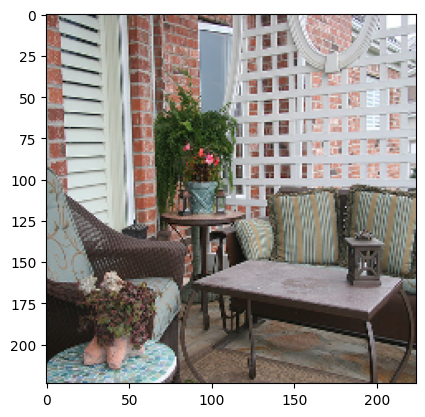

In [ ]:
CLASSES = {'aeroplane': 0, 'bicycle': 1, 'bird': 2, 'boat': 3, 'bottle': 4, 'bus': 5,
           'car': 6, 'cat': 7, 'chair': 8, 'cow': 9, 'diningtable': 10, 'dog': 11,
           'horse': 12, 'motorbike':13, 'person': 14, 'pottedplant': 15, 'sheep': 16,
           'sofa': 17, 'train': 18, 'tvmonitor': 19}

print(test_pred[1])

plt.imshow(to_test[1]/255)
plt.show

In [ ]:
test_df.loc[:, labels] = model.predict(test_df["img"])
test_df.head(1)

,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[-1, -1, -1, -1, -1, -1, -1, -1, -1, -1, -1, ..."


# 3. Semantic segmentation
The goal here is to implement a segmentation CNN that labels every pixel in the image as belonging to one of the 20 classes (and/or background). Use the training set to train your CNN and compete on the test set (by filling in the segmentation column in the test dataframe).

In [ ]:
class RandomSegmentationModel:
    """
    Random segmentation model: 
        - generates random label maps for the inputs based on the class distributions observed during training
        - every pixel in an input can only have one label
    """
    def fit(self, X, Y):
        """
        Adjusts the class ratio variable to the one observed in Y. 

        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
        Y: list of arrays - n x (height x width)

        Returns
        -------
        self
        """
        self.distribution = np.mean([[np.sum(Y_ == i) / Y_.size for i in range(len(labels) + 1)] for Y_ in Y], axis=0)
        print("Setting class distribution to:\nbackground: {}\n{}".format(self.distribution[0], "\n".join(f"{label}: {p}" for label, p in zip(labels, self.distribution[1:]))))
        return self
        
    def predict(self, X):
        """
        Predicts for each input a label map.
        
        Parameters
        ----------
        X: list of arrays - n x (height x width x 3)
            
        Returns
        -------
        Y_pred: list of arrays - n x (height x width)
        """
        np.random.seed(0)
        return [np.random.choice(np.arange(len(labels) + 1), size=(224,224), p=self.distribution) for X_ in X]
    
    def __call__(self, X):
        return self.predict(X)
    
model = RandomSegmentationModel()
model.fit(train_df["img"], train_df["seg"])
pred = model.predict(test_df["img"])
print(len(pred))
test_df.loc[:, "seg"] = pred
test_df.head(1)

Setting class distribution to:
background: 0.7774704888071216
aeroplane: 0.007051912139390122
bicycle: 0.0030340461305405344
bird: 0.009781050583857026
boat: 0.007920222121661963
bottle: 0.00801371700061968
bus: 0.014444057783372053
car: 0.01299203192837253
cat: 0.016639155300546396
chair: 0.008264122763258911
cow: 0.006782009244183503
diningtable: 0.013744445666126768
dog: 0.0074080558785160075
horse: 0.008338953677311486
motorbike: 0.01079509937004467
person: 0.041013621147577735
pottedplant: 0.00539385590505006
sheep: 0.009157332163106574
sofa: 0.00958005931515607
train: 0.012118249521815817
tvmonitor: 0.010057513552370658
750


,aeroplane,bicycle,bird,boat,bottle,bus,car,cat,chair,cow,...,horse,motorbike,person,pottedplant,sheep,sofa,train,tvmonitor,img,seg
Id,,,,,,,,,,,,,,,,,,,,,
0,0,0,0,0,0,0,0,0,0,0,...,0,0,1,0,1,0,0,0,"[[[139, 130, 115], [136, 127, 112], [112, 102,...","[[0, 0, 0, 0, 0, 0, 0, 12, 17, 0, 3, 0, 0, 15,..."


## Submit to competition
You don't need to edit this section. Just use it at the right position in the notebook. See the definition of this function in Sect. 1.3 for more details.

In [ ]:
generate_submission(test_df)

,Predicted
Id,
0_classification,15 1 17 1
0_segmentation,19 1 24 1 335 1 429 1 720 1 779 1 884 1 1025 1...
1_classification,15 1
1_segmentation,52 1 244 1 445 1 942 1 1011 1 1280 1 1549 1 15...
2_classification,4 1 15 1
...,...
747_segmentation,110 1 259 1 296 1 489 1 872 1 1122 1 1145 1 12...
748_classification,6 1 19 1
748_segmentation,357 1 406 1 412 1 684 1 726 1 1199 1 1245 1 16...


# 4. Adversarial attack
For this part, your goal is to fool your classification and/or segmentation CNN, using an *adversarial attack*. More specifically, the goal is build a CNN to perturb test images in a way that (i) they look unperturbed to humans; but (ii) the CNN classifies/segments these images in line with the perturbations.

Get data

In [740]:
CLASSES = train_df.columns[:-2]
LABEL_1 = 'motorbike'
#get the id of the label
ID_LABEL_1 = np.where(CLASSES == LABEL_1)[0][0]

print("The label {} has the ID {}.".format(LABEL_1, ID_LABEL_1))
train_binary = pd.DataFrame()

train_binary["img"] = train_df["img"]
train_binary["label"] = train_df[LABEL_1]
print("The training set contains {} examples.".format(len(train_binary)))

#number of LABEL_1 images
n_label_1 = np.sum(train_binary["label"])
print("The training set contains {} images with the label {}.".format(n_label_1, LABEL_1))

The label motorbike has the ID 13.
The training set contains 749 examples.
The training set contains 47 images with the label motorbike.


(749, 224, 224, 3)


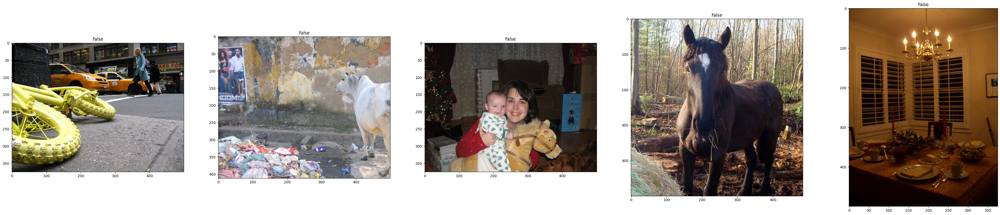

In [ ]:
#get train and test data
train_ad_img = train_binary["img"].to_numpy()
#get labels for LABEL_1
train_ad_labels = train_binary[LABEL_1].to_numpy()

deciptive_labels = 1 - train_ad_labels
#check if the labels are correct
plt.subplots(1, 5, figsize=(10 * 5, 10 * 1))
for i in range(5):
    rand_idx = np.random.randint(len(train_binary))
    plt.subplot(1, 5, i+1), plt.imshow(train_binary.iloc[rand_idx]["img"], vmin=0, vmax=255)
    if train_binary.iloc[rand_idx][LABEL_1] == 1:
        plt.title(LABEL_1)
    else:
        plt.title(not LABEL_1)


#resize images
IMG_SIZE = (224,224)
train_ad_img_resized = []
for i, img in enumerate(train_ad_img):
    train_ad_img_resized.append(resize_image(img, IMG_SIZE[0], IMG_SIZE[1]))
train_ad_img_resized = np.array(train_ad_img_resized, dtype=np.float32)

#scale images
train_ad_img_resized = train_ad_img_resized/255


print(train_ad_img_resized.shape)

In [938]:
# create a balanced dataset with equal number of LABEL_1 and not LABEL_1 images
train_binary_balanced = train_binary[train_binary["label"] == 1]
n_label_1 = len(train_binary_balanced)
print("The training set contains {} images with the label {}.".format(n_label_1, LABEL_1))
train_binary_balanced = train_binary_balanced.append(train_binary[train_binary["label"] == 0].sample(n=n_label_1, replace=True))

#shuffle data
train_binary_balanced = train_binary_balanced.sample(frac=1).reset_index(drop=True)
print("The data set contains {} examples.".format(len(train_binary_balanced)))


# convert to numpy arrays
X_b = train_binary_balanced["img"].to_numpy()
y_b = train_binary_balanced["label"].to_numpy()


#resize images
IMG_SIZE = (224,224)
X_resized = []
for i, img in enumerate(X_b):
    X_resized.append(resize_image(img, IMG_SIZE[0], IMG_SIZE[1]))
X_resized = np.array(X_resized, dtype=np.float32)

#split data
Xb_train,Xb_test,yb_train, yb_test = train_test_split(X_resized, y_b, test_size=0.3, random_state=42)

#check sizes
print("Training set:", Xb_train.shape, yb_train.shape)

#scale images
# mean = np.mean(Xb_train, axis=0)
# Xb_train = (Xb_train - mean) / 255
# Xb_test = (Xb_test - mean) / 255


The training set contains 47 images with the label motorbike.
The data set contains 94 examples.


C:\Users\alexi\AppData\Local\Temp\ipykernel_9880\2178892054.py:5: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  train_binary_balanced = train_binary_balanced.append(train_binary[train_binary["label"] == 0].sample(n=n_label_1, replace=True))


Training set: (65, 224, 224, 3) (65,)


Build the adversarial model:  Autoencoder --> noisy images --> Binary classifier(based on resnet model)

In [939]:
#Build the autoencoder

import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, BatchNormalization
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanSquaredError
#import Activation layer
from tenserflow.keras.layers import Activation
import matplotlib.pyplot as plt
import numpy as np

# Define the input shape
input_img = Input(shape = (IMG_SIZE[0], IMG_SIZE[1], 3))

print(input_img.shape)
# Encoder
x = Conv2D(16, (3, 3), activation='relu', padding='same')(input_img)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = MaxPooling2D((2, 2), padding='same')(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
encoded = MaxPooling2D((2, 2), padding='same')(x)

print(encoded.shape)
# Decoder
x = Conv2D(8, (3, 3),  activation='relu', padding='same')(encoded)
x = UpSampling2D((2, 2))(x)
x = Conv2D(8, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
x = Conv2D(16, (3, 3), activation='relu', padding='same')(x)
x = UpSampling2D((2, 2))(x)
decoded = Conv2D(3, (3, 3), activation='sigmoid', padding='same')(x)


print(decoded.shape)

(None, 224, 224, 3)
(None, 28, 28, 8)
(None, 224, 224, 3)


In [950]:
#create function to add perturbations to the images
from keras import backend as K

def regularize(args):
  decoded, input_img = args
  R = 800 #this is the maximum L2 norm of the perturbation
  a = K.minimum(K.pow(K.sqrt(K.sum(K.square(decoded))),-1)*R,1) 
  return decoded*a

# Add perturbation
def add_perturbations(args):
  perturbation,input_img = args
  b = K.clip(perturbation/255 +input_img/255,0,1)
  #same format as input_img
  return b*255

In [951]:
#Layers in the adversarial model to add perturbations
from tensorflow.keras.layers import Lambda

perturbation = Lambda(regularize, output_shape=input_shape, name='scale')([decoded, input_img])
fakeimage = Lambda(add_perturbations, output_shape=input_shape, name='fakeimage')([perturbation ,input_img])

In [954]:
#build binary classifier model
#import activation function
from tensorflow.keras.layers import Activation

classifier = resnet_model #based on the resnet model from section 3

# set trainable to false for all layers
for layer in classifier.layers:
    layer.trainable = False

classifier.trainable = False

binary_model = Sequential([
    classifier,
    #add layer that selects the ID_LABEL_1 output of the resnet model and binarizes it
    #Lambda(lambda x: x[:,ID_LABEL_1]),
    #Lambda(lambda x: tf.keras.backend.cast(x>0.4, np.float32))
    Dense(1, activation='sigmoid', name='binary')
])

binary_model.compile(optimizer='adam',loss='binary_crossentropy',metrics=['accuracy'])


#train binary model
history = binary_model.fit(Xb_train, yb_train, epochs=1, batch_size=16, validation_split=0.2, verbose=0)

# Visualize the training
fig, axs = plt.subplots(1,2)
# summarize history for precision
axs[0].plot(history.history['accuracy'])
axs[0].plot(history.history['val_accuracy'])
axs[0].set_title('model accuracy')
axs[0].set_ylabel('accuracy')
axs[0].set_xlabel('epoch')


#evaluate binary model
#binary_model.evaluate(Xb_test, yb_test)

# train with data augmentation
# datagen = ImageDataGenerator(rotation_range=90, width_shift_range=0.2
#                                ,height_shift_range=0.2, shear_range=0.2,zoom_range=0.2
#                                ,fill_mode="nearest", horizontal_flip=True)
# datagen.fit(Xb_train)

# history = binary_model.fit(datagen.flow(Xb_train, yb_train, batch_size=32),
#                           epochs=15, verbose=1, workers=4, shuffle=True)




4/4 [==============================] - 19s 3s/step - loss: 0.2744 - accuracy: 0.2500 - val_loss: 0.4336 - val_accuracy: 0.0000e+00


In [ ]:
#see outputs of binary model
y_pred = binary_model.predict(Xb_test)
print(y_pred)

Predictions

In [898]:
#test binary model

predictions = binary_model.predict(Xb_test)
print(predictions.shape)

# predictions = predictions[:,ID_LABEL_1]
predictions = np.array(predictions>0.4, int).reshape(-1)

print(predictions[0:40])
print(yb_test[0:40])

# evaluate the model performance on the test set
print("Accuracy:", np.mean(predictions == yb_test))


1/1 [==============================] - 4s 4s/step
(29,)
[0 1 0 1 0 0 0 0 0 0 1 0 0 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0]
[0 1 0 1 0 0 0 0 1 0 1 0 1 0 1 0 0 1 1 1 1 0 1 0 0 0 1 1 0]
Accuracy: 0.9310344827586207


In [955]:
# build the adversarial model
outputs = binary_model(fakeimage)

adversarial_model = Model(inputs =input_img, outputs = outputs)
adversarial_model.Layers[-1].trainable = False
adversarial_model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

deceptive_labels = 1 - yb_train
# Train the model
adversarial_model.fit(Xb_train, deceptive_labels, epochs=1, batch_size=10, validation_split=0.2)



6/6 [==============================] - 47s 6s/step - loss: 7.3019 - accuracy: 0.0000e+00 - val_loss: 6.7772 - val_accuracy: 0.5000


In [956]:
perturbation_model = Model(inputs = adversarial_model.input, outputs = adversarial_model.get_layer('scale').output)
perturbations = perturbation_model.predict(Xb_train)

reconstruction_layer = Model(inputs = adversarial_model.input, outputs = adversarial_model.get_layer('fakeimage').output)
image_pert = reconstruction_layer.predict(Xb_train)

3/3 [==============================] - 1s 311ms/step


(array([ 2,  3,  4,  6,  7, 10, 16, 18, 19, 20, 21, 23, 25, 26, 29, 30, 31,
       32, 33, 38, 39, 40, 41, 43, 45, 46, 47, 49, 50, 52, 54, 55, 56, 58,
       61], dtype=int64),)


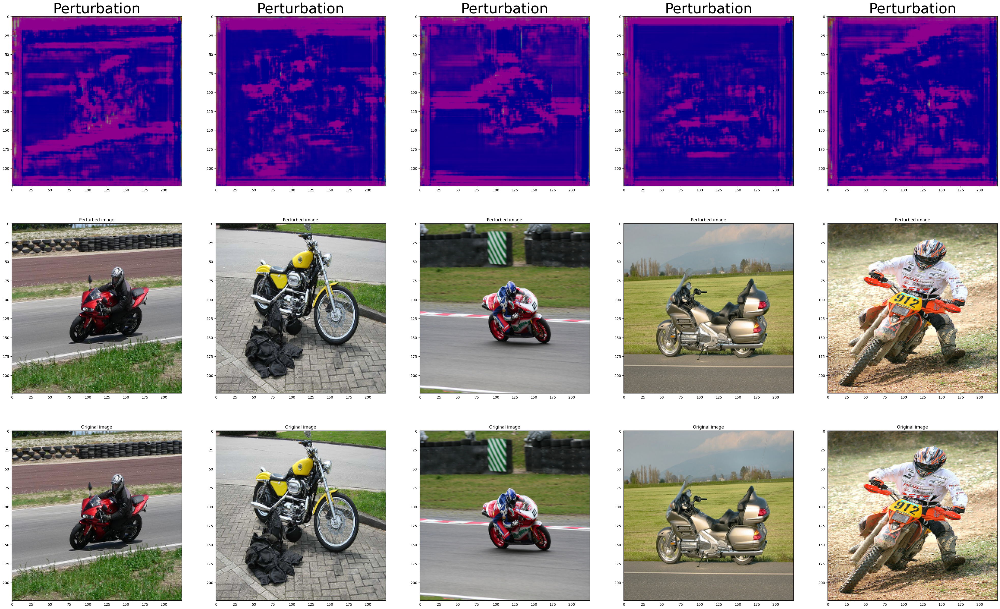

In [967]:

#plot perturbations for some images
plt.subplots(3, 5, figsize=(10 * 5, 10 * 3))
labels_indicies = np.where(yb_train==1)
print(labels_indicies)
for i in range(5):
    #plot motorbike image
    # rand_idx = np.random.randint(len(X_test))
    plt.subplot(3, 5, i+1), plt.imshow(perturbations[labels_indicies[0][i]]),plt.title("Perturbation", fontsize=40)
    plt.subplot(3, 5, i+6), plt.imshow(image_pert[labels_indicies[0][i]]/255),  plt.title("Perturbed image")
    plt.subplot(3, 5, i+11), plt.imshow(Xb_train[labels_indicies[0][i]]/255),  plt.title("Original image")


In [874]:

def show_original_decepted(orig, dec, y_orig,y_dec, y_predict,pred_binary,num=10):
  plt.figure(figsize=(20,5))
  next_ = 1
  for i in range(len(y_orig)):
    if next_ == num:
      break
    if int(np.round(y_predict[i])) == y_dec[i]:
      # display original
      ax = plt.subplot(2, num, next_+1)
      plt.imshow(orig[i]/255)
      ax.set_title(
                  "Fooled @" + str(i) 
                )
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)

      # display fake image
      ax = plt.subplot(2, num, next_ +1 + num)
      plt.imshow(dec[i]/255)
      ax.get_xaxis().set_visible(False)
      ax.get_yaxis().set_visible(False)
      next_+=1
    else:
      continue        
  plt.show()

In [814]:
#set deciptive labels
y_train_dec = 1 - yb_train

3/3 [==============================] - 12s 3s/step


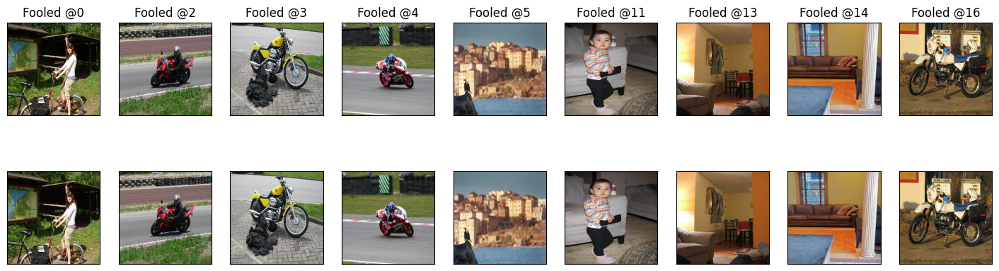

In [958]:
adversial_model = adversarial_model
layer_name = 'fakeimage'
intermediate_layer_model = Model(inputs=adversial_model.input,outputs=adversial_model.get_layer(layer_name).output)
image_gen = intermediate_layer_model.predict(Xb_train)
output = adversial_model.predict(Xb_train)
show_original_decepted(Xb_train, image_gen,yb_train,y_train_dec,output,predictions,10)

Plot noise provided bu autoencoder

In [ ]:
# Combine Encoder and Decoder into one Model
autoencoder = Model(input_img, decoded)
autoencoder.compile(optimizer='adam' ,loss='binary_crossentropy')

# Train the model
autoencoder.fit(X_train, X_train, epochs=10, batch_size=16, shuffle=True, validation_split=0.2)

autoencoder.summary()

2/2 [==============================] - 0s 194ms/step


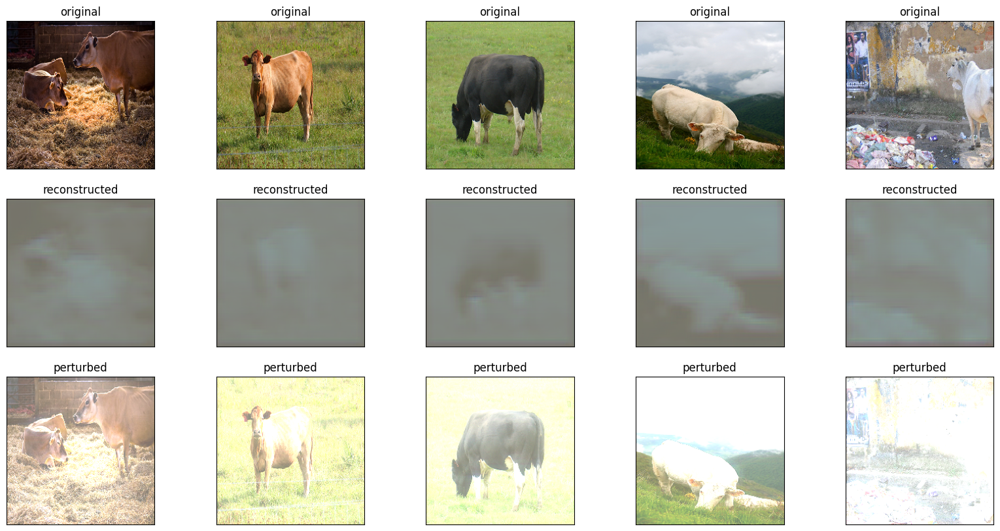

In [ ]:
#plot some results

decoded_imgs = autoencoder.predict(train_ad_img_resized)
train_ad_img_resized_pert = add_perturbations([decoded_imgs, train_ad_img_resized])
n = 5
plt.figure(figsize=(20, 10))
for i in range(n):
    # display original
    ax = plt.subplot(3, n, i + 1)
    plt.imshow(train_ad_img_resized[i])
    plt.title("original")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # display reconstruction
    ax = plt.subplot(3, n, i + 1 + 2*n)
    plt.imshow(train_ad_img_resized_pert[i])
    plt.title("perturbed")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)

    # display reconstruction
    ax = plt.subplot(3, n, i + 1 + n)
    plt.imshow(decoded_imgs[i])
    plt.title("reconstructed")
    plt.gray()
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
plt.show()



In [ ]:



CNN_classifier = our_model

def adversarial_pattern(input_image, input_label):
    loss_object = tf.keras.losses.SparseCategoricalCrossentropy()
    with tf.GradientTape() as tape:
        prediction = CNN_classifier.predict(input_image)
        loss = loss_object(input_label, prediction)
        tape.watch(input_image)

    gradient = tape.gradient(loss, input_image)

    signed_grad = tf.sign(gradient)
    return signed_grad

X_train_adversarial = []
X_test_adversarial = []

for i in range(len(X_train)):
    perturbations = adversarial_pattern(X_train[i].reshape((1, 224, 224, 3)), y_train[i])
    X_train_adversarial.append(X_train[i] + perturbations.numpy()*0.1)
X_train_adversarial = np.array(X_train_adversarial).astype('float32')

for i in range(len(X_test)):
    perturbations = adversarial_pattern(X_test[i].reshape((1, 224, 224, 3)), y_test[i])
    X_test_adversarial.append(X_test[i] + perturbations.numpy()*0.1)
X_test_adversarial = np.array(X_test_adversarial).astype('float32')

autoencoder.fit(X_train, X_train_adversarial, epochs=50, batch_size=128, validation_data=(X_test, X_test_adversarial))


def generate_adversarial_images(images):
    adversarial_images = autoencoder.predict(images)
    return adversarial_images

adversarial_images = generate_adversarial_images(X_test)

# Visualize some examples
for i in range(5):
    print('Original image class: ', y_test[i])
    print('Adversarial image class: ', np.argmax(CNN_classifier.predict(adversarial_images[i].reshape((1, 224, 224, 3)))))

    plt.imshow(X_test[i])
    plt.show()

    plt.imshow(adversarial_images[i])
    plt.show()

LookupError: No gradient defined for operation'IteratorGetNext' (op type: IteratorGetNext). In general every operation must have an associated `@tf.RegisterGradient` for correct autodiff, which this op is lacking. If you want to pretend this operation is a constant in your program, you may insert `tf.stop_gradient`. This can be useful to silence the error in cases where you know gradients are not needed, e.g. the forward pass of tf.custom_gradient. Please see more details in https://www.tensorflow.org/api_docs/python/tf/custom_gradient.

# 5. Discussion
Finally, take some time to reflect on what you have learned during this assignment. Reflect and produce an overall discussion with links to the lectures and "real world" computer vision.

**Preprocessing**: Resize the images into the same shape.

Idea 1: Crop squares of predefinded shape from the 4 corners and the center of the image (image resizing + data augmentation, 5x bigger dataset). However, not necessarily good because cropping can result in images that don't contain all the objects of the original image and thus they should have different labels. (see example below: some cropped images contain only the horse and not the person, so their label should be different)
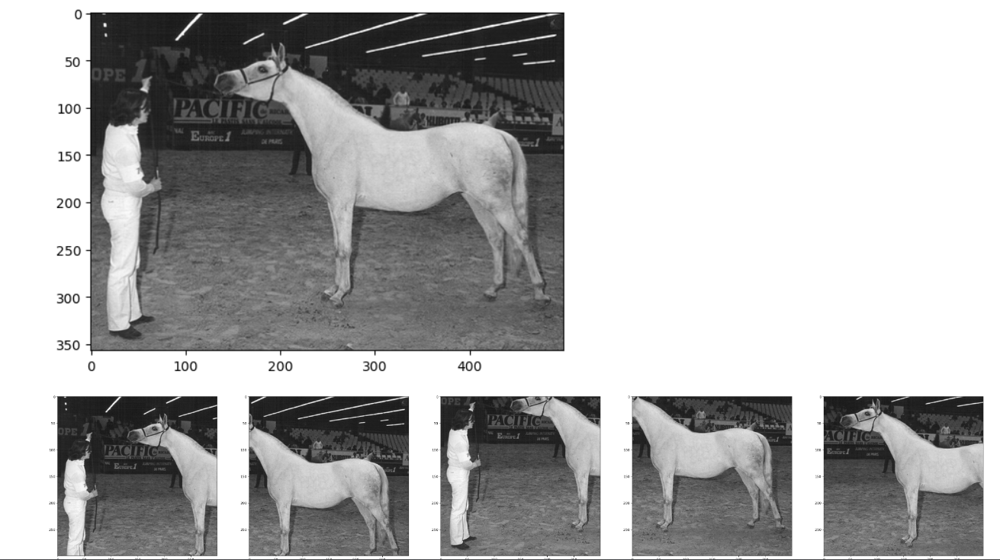

Idea 2: Just resize the images in a predefined shape. We choose this shape to be the average dimensions of the training images, namely (360,500) for horizontal and (500,360) for vertical images
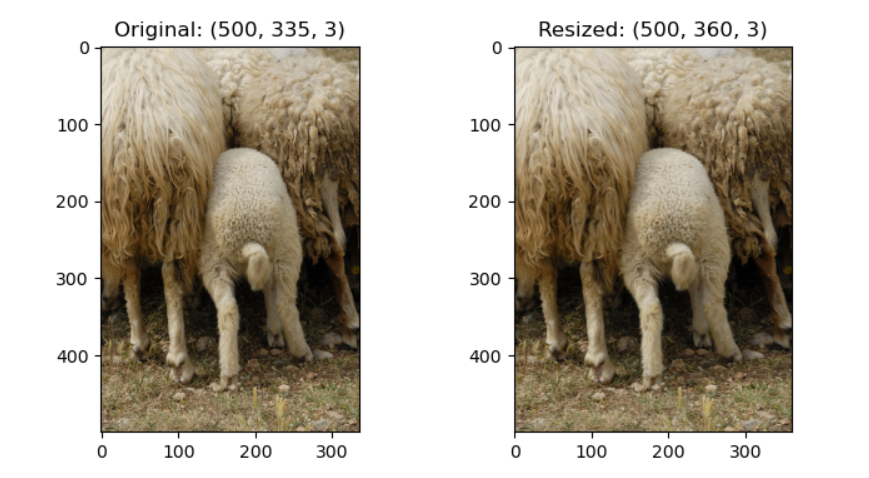
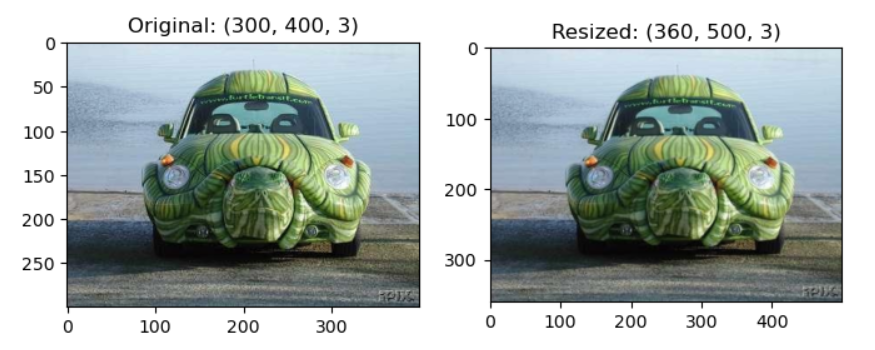

Idea 3: Image resizing + padding for the vertical images (~20% of the training set), to obtain a set of images with the same dimensions
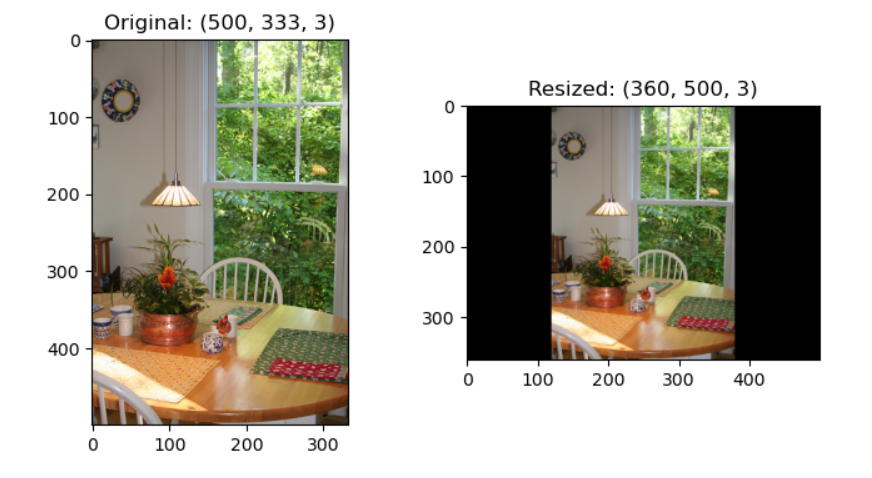

**Image Classification**: Building a CNN

Imbalanced dataset: 27% of samples belong to class 'person', 3-8 times more than the samples from the other classes.
How to deal with it?
- Data Augmentation:
    Augment the training dataset and make it as balanced as possible (rotation, flip, brightness). 
- Evaluate using F1 score and NOT accuracy
    So far 0.5 on average (0.3-0.7 depending on the class)
- Use class_weights while training the model: does not improve performance, just gives a more realistic image for the actual performance of the model

NEXT STEPS:
- Try padding with nearest-neighbor and not rotation
- Train the Inception resnet